# Column relation analysis inside the data

* correlation analysis
* dispersion analysis
* data dimension reduction (PCA, t-SNE)

[Crab Data source](https://www.kaggle.com/datasets/sidhus/crab-age-prediction)

# Import the dependencies

In [52]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Load the data

In [2]:
crab_df = pd.read_csv("./src/CrabAgePrediction.csv")

In [3]:
crab_df.head()

,Sex,Length,Diameter,Height,Weight,Shucked Weight,Viscera Weight,Shell Weight,Age
0,F,1.4375,1.1750,0.4125,24.635715,12.332033,5.584852,6.747181,9
1,M,0.8875,0.6500,0.2125,5.400580,2.296310,1.374951,1.559222,6
2,I,1.0375,0.7750,0.2500,7.952035,3.231843,1.601747,2.764076,6
3,F,1.1750,0.8875,0.2500,13.480187,4.748541,2.282135,5.244657,10
4,I,0.8875,0.6625,0.2125,6.903103,3.458639,1.488349,1.700970,6


In [4]:
set(crab_df["Sex"])

{'F', 'I', 'M'}

In [5]:
sex_mapping = {
    "F": -1, "I": 0, "M": 1,
}

crab_df["Sex"] = [
    sex_mapping[sex_name] for sex_name in crab_df["Sex"]
] 

In [6]:
crab_df.head()

,Sex,Length,Diameter,Height,Weight,Shucked Weight,Viscera Weight,Shell Weight,Age
0,-1,1.4375,1.1750,0.4125,24.635715,12.332033,5.584852,6.747181,9
1,1,0.8875,0.6500,0.2125,5.400580,2.296310,1.374951,1.559222,6
2,0,1.0375,0.7750,0.2500,7.952035,3.231843,1.601747,2.764076,6
3,-1,1.1750,0.8875,0.2500,13.480187,4.748541,2.282135,5.244657,10
4,0,0.8875,0.6625,0.2125,6.903103,3.458639,1.488349,1.700970,6


In [7]:
crab_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3893 entries, 0 to 3892
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Sex             3893 non-null   int64  
 1   Length          3893 non-null   float64
 2   Diameter        3893 non-null   float64
 3   Height          3893 non-null   float64
 4   Weight          3893 non-null   float64
 5   Shucked Weight  3893 non-null   float64
 6   Viscera Weight  3893 non-null   float64
 7   Shell Weight    3893 non-null   float64
 8   Age             3893 non-null   int64  
dtypes: float64(7), int64(2)
memory usage: 273.9 KB


# Show Correlation Matrix

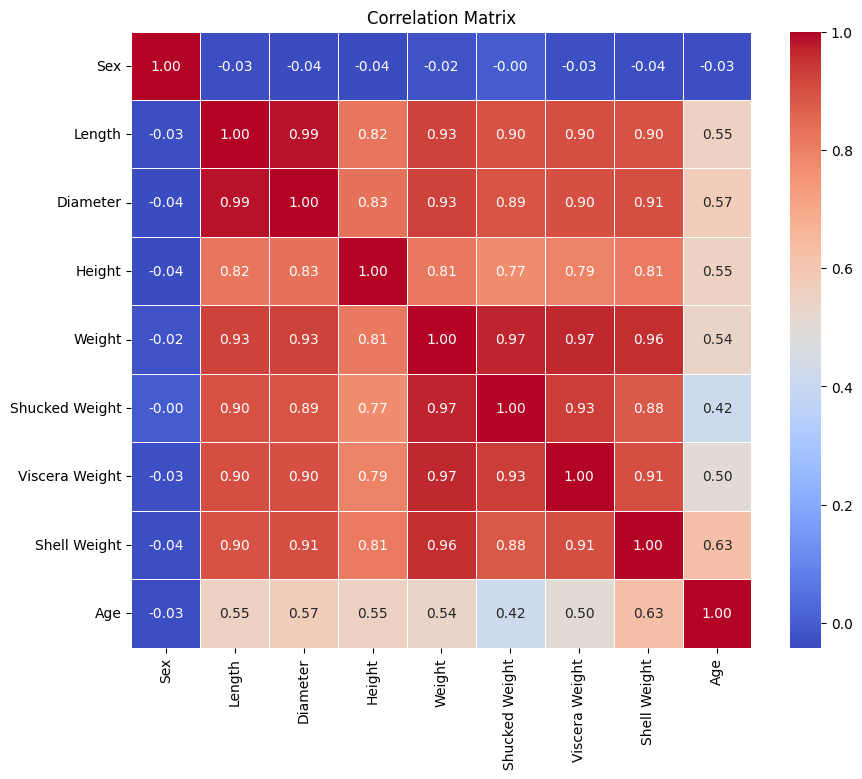

In [63]:
corr_matrix = crab_df.corr()

# Draw corr_matrix as heat map
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [22]:
crab_df_cropped = crab_df[["Sex", "Length", "Height", "Shucked Weight", "Age"]]

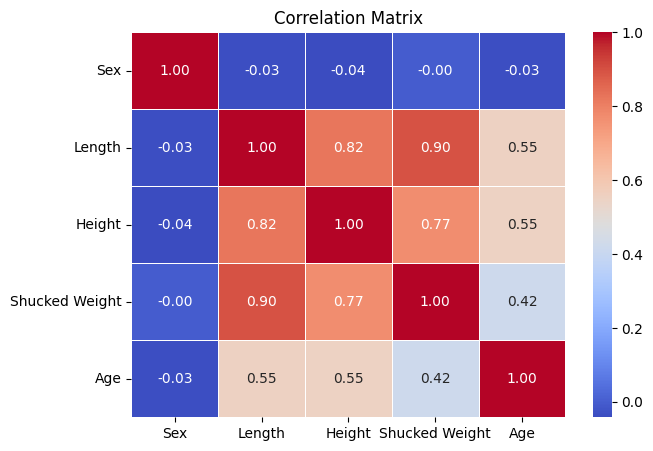

In [23]:
corr_matrix = crab_df_cropped.corr()

# Draw corr_matrix as heat map
plt.figure(figsize=(7, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

# Do dispersion analysis

In [20]:
crab_df.describe()

,Sex,Length,Diameter,Height,Weight,Shucked Weight,Viscera Weight,Shell Weight,Age
count,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000
mean,0.053943,1.311306,1.020893,0.349374,23.567275,10.207342,5.136546,6.795844,9.954791
std,0.824950,0.300431,0.248233,0.104976,13.891201,6.275275,3.104133,3.943392,3.220967
min,-1.000000,0.187500,0.137500,0.000000,0.056699,0.028349,0.014175,0.042524,1.000000
25%,-1.000000,1.125000,0.875000,0.287500,12.672227,5.343881,2.664853,3.713785,8.000000
50%,0.000000,1.362500,1.062500,0.362500,22.792998,9.539607,4.861939,6.662133,10.000000
75%,1.000000,1.537500,1.200000,0.412500,32.786197,14.273973,7.200773,9.355335,11.000000
max,1.000000,2.037500,1.625000,2.825000,80.101512,42.184056,21.545620,28.491248,29.000000


In [24]:
crab_df_cropped.describe()

,Sex,Length,Height,Shucked Weight,Age
count,3893.000000,3893.000000,3893.000000,3893.000000,3893.000000
mean,0.053943,1.311306,0.349374,10.207342,9.954791
std,0.824950,0.300431,0.104976,6.275275,3.220967
min,-1.000000,0.187500,0.000000,0.028349,1.000000
25%,-1.000000,1.125000,0.287500,5.343881,8.000000
50%,0.000000,1.362500,0.362500,9.539607,10.000000
75%,1.000000,1.537500,0.412500,14.273973,11.000000
max,1.000000,2.037500,2.825000,42.184056,29.000000


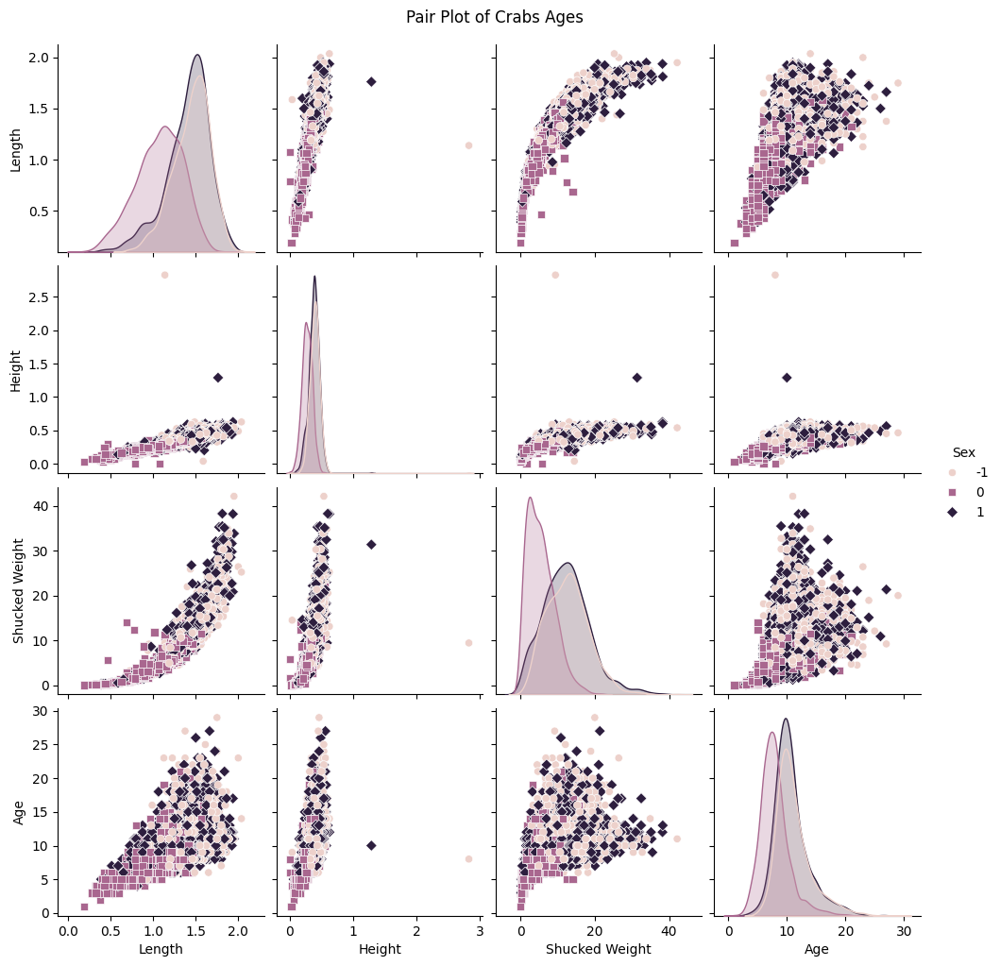

In [28]:
sns.pairplot(crab_df_cropped, hue='Sex', markers=["o", "s", "D"])
plt.suptitle("Pair Plot of Crabs Ages", y=1.02)
plt.show()

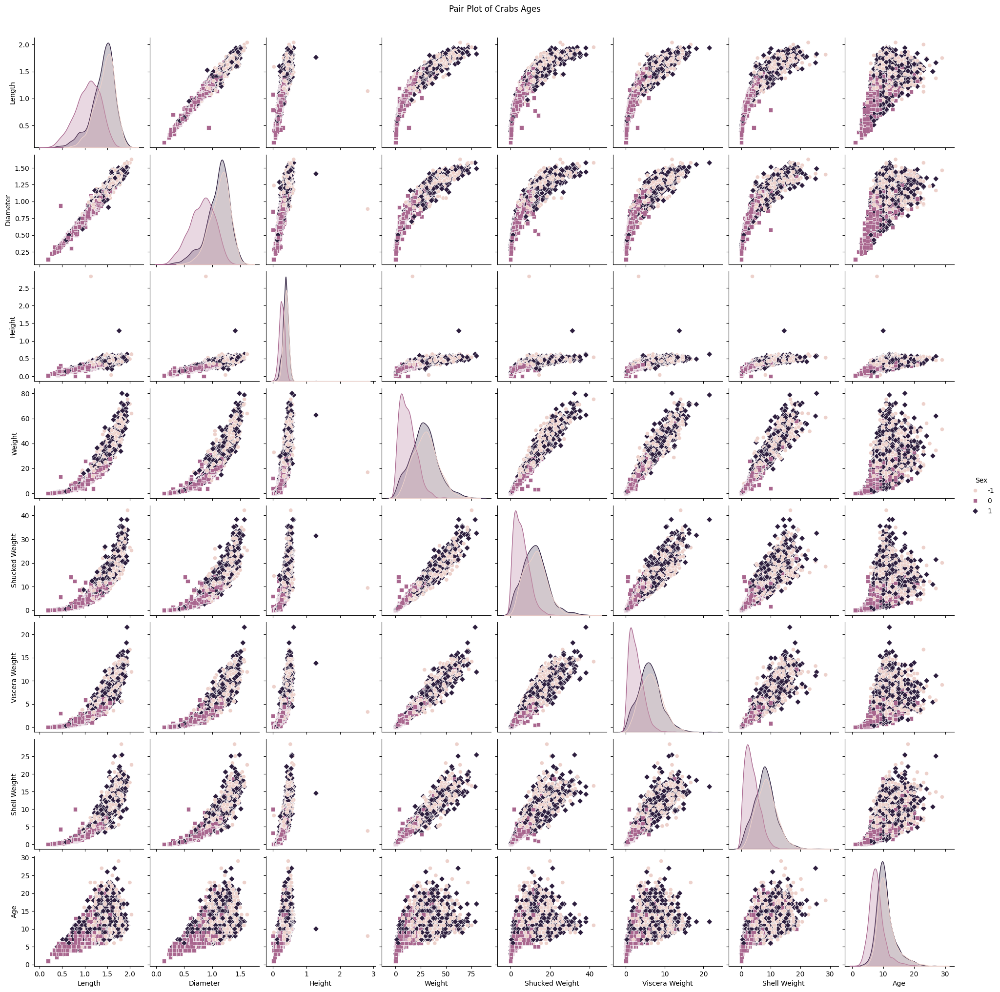

In [29]:
sns.pairplot(crab_df, hue='Sex', markers=["o", "s", "D"])
plt.suptitle("Pair Plot of Crabs Ages", y=1.02)
plt.show()

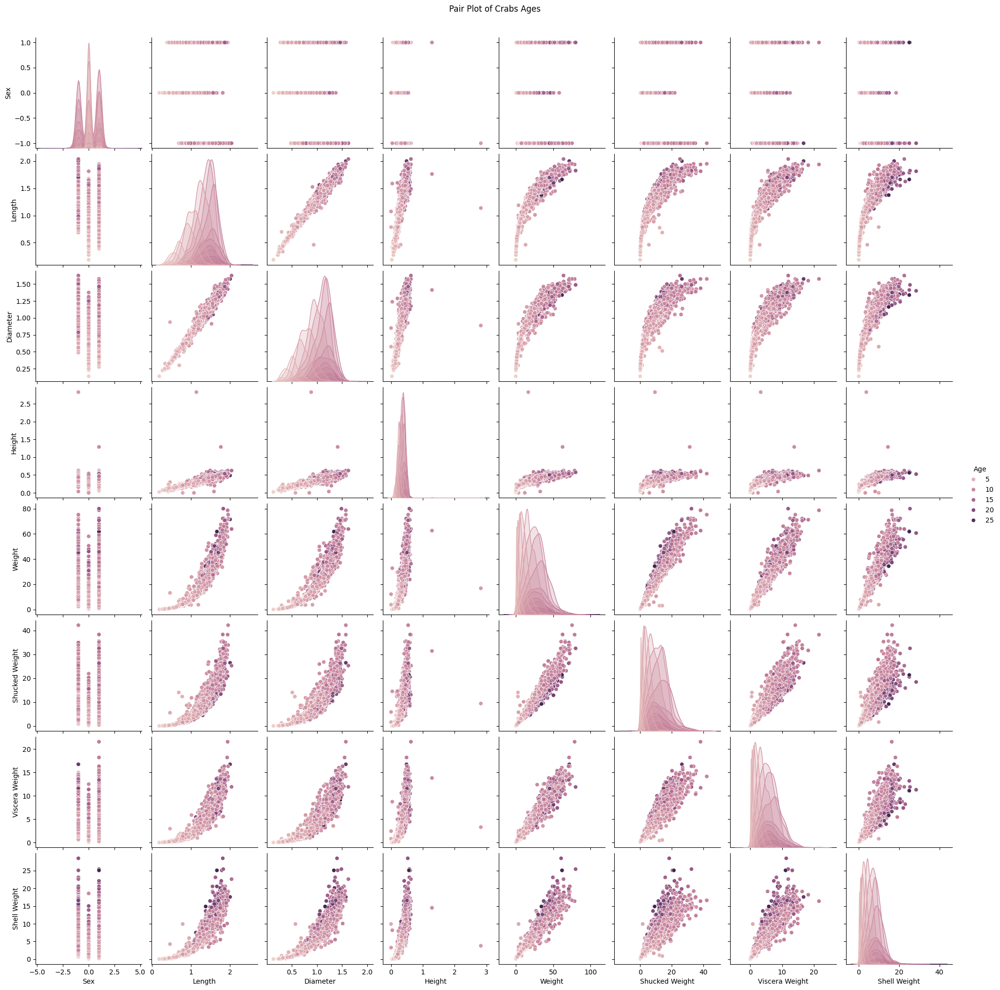

In [30]:
sns.pairplot(crab_df, hue='Age')
plt.suptitle("Pair Plot of Crabs Ages", y=1.02)
plt.show()

# Detect outliers

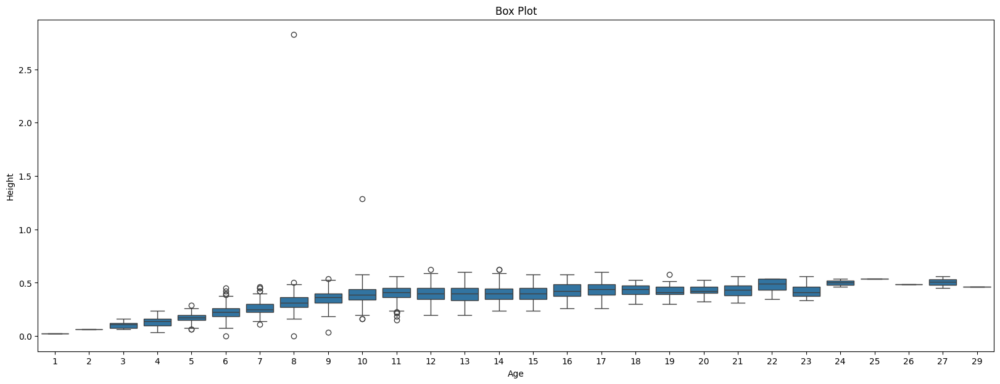

In [35]:
plt.figure(figsize=(20, 7))
sns.boxplot(data=crab_df, x='Age', y='Height')
plt.title("Box Plot")
plt.show()

In [37]:
# Function to remove outliers based on IQR for each class
def remove_outliers_by_class(df, column_name, class_column):
    cleaned_groups = []

    # Group by class
    grouped = df.groupby(class_column)

    for name, group in grouped:
        Q1 = group[column_name].quantile(0.25)
        Q3 = group[column_name].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Filter the group to remove outliers
        cleaned_group = group[(group[column_name] >= lower_bound) & (group[column_name] <= upper_bound)]
        cleaned_groups.append(cleaned_group)

    # Combine the cleaned groups into a single DataFrame
    df_cleaned = pd.concat(cleaned_groups)
    return df_cleaned

In [45]:
crab_df_clean = remove_outliers_by_class(crab_df, "Height", "Age")

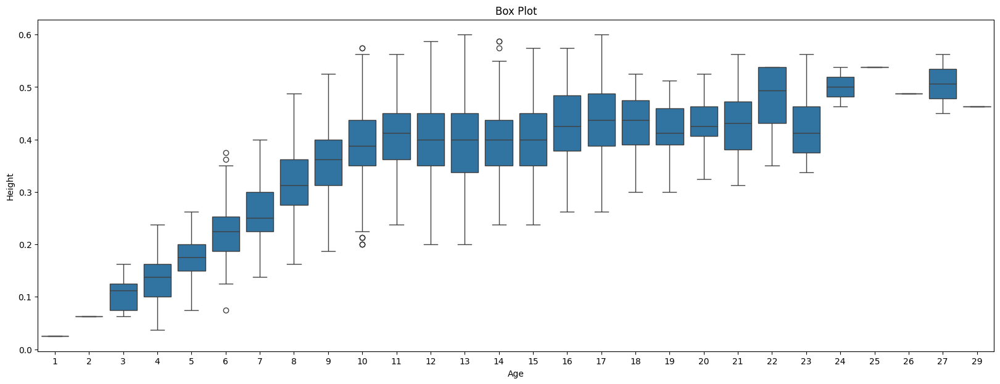

In [46]:
plt.figure(figsize=(20, 7))
sns.boxplot(data=crab_df_clean, x='Age', y='Height')
plt.title("Box Plot")
plt.show()

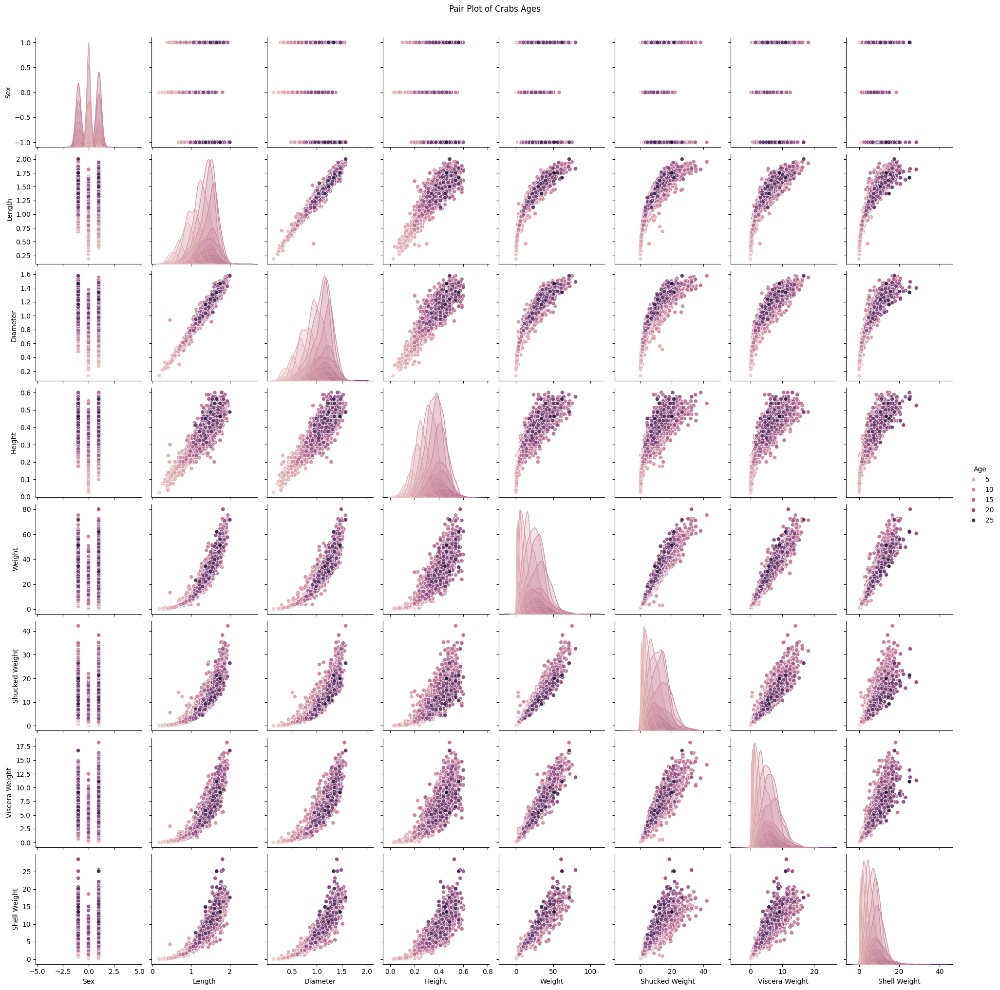

In [47]:
sns.pairplot(crab_df_clean, hue='Age')
plt.suptitle("Pair Plot of Crabs Ages", y=1.02)
plt.show()

In [48]:
crab_df_c_cropped = crab_df_clean[["Sex", "Length", "Height", "Shucked Weight", "Age"]]

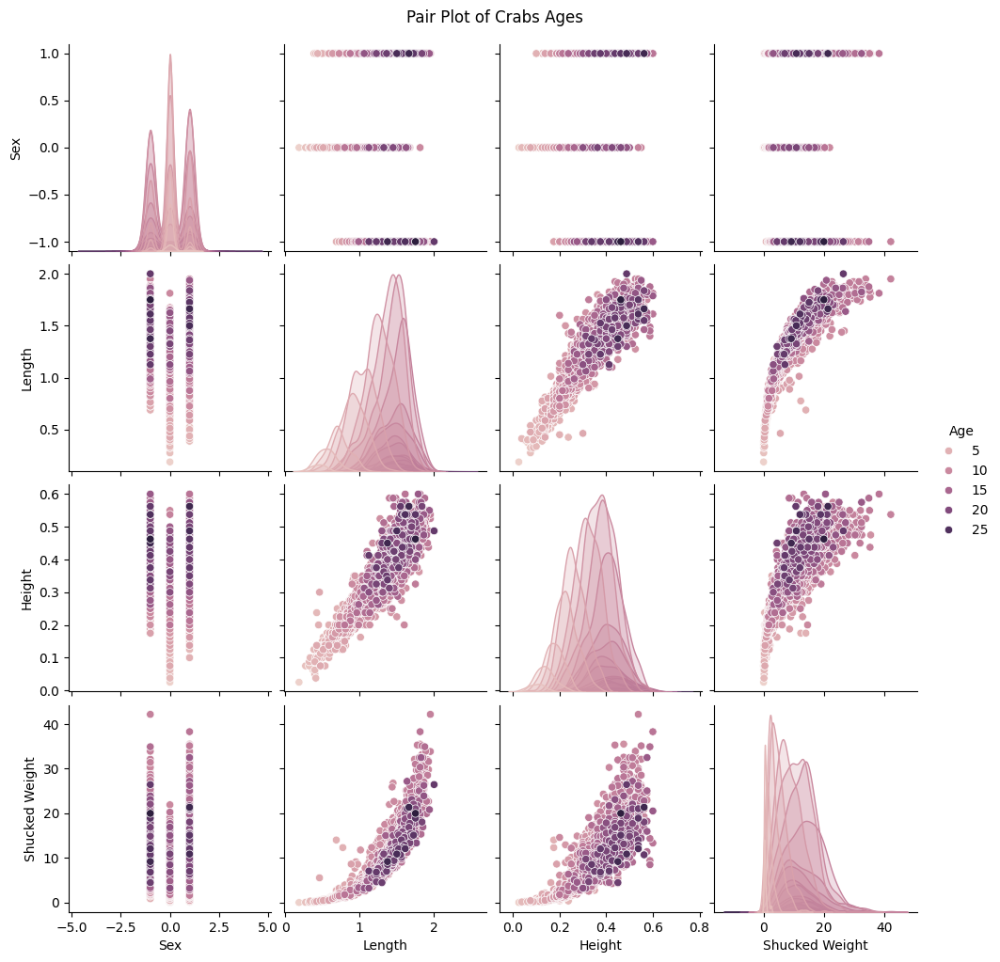

In [49]:
sns.pairplot(crab_df_c_cropped, hue='Age')
plt.suptitle("Pair Plot of Crabs Ages", y=1.02)
plt.show()

# PCA & t-SNE

In [53]:
pca_3d = PCA(n_components=3)  # Set the number of components as needed
principal_components_3d = pca_3d.fit_transform(crab_df_clean.drop('Age', axis=1))

tsne_3d = TSNE(n_components=3, random_state=42)
embedded_data_3d = tsne_3d.fit_transform(crab_df_clean.drop('Age', axis=1))


def visualize_clusters_3d_pca(labels_, clustering_method,
                              label_mapping=None):
    pca_df_3d = pd.DataFrame(data=principal_components_3d, columns=['PC1', 'PC2', 'PC3'])
    pca_df_3d['class'] = labels_
    # pca_df_3d['class'] = pca_df_3d['class'].map(label_mapping)

    fig = px.scatter_3d(
        pca_df_3d, x='PC1', y='PC2', z='PC3',
        color='class', title=f"PCA 3D, {clustering_method}",
        width=600, height=600,
        size=[5] * len(pca_df_3d),
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()


def visualize_clusters_3d_tsne(labels_, clustering_method, label_mapping=None):
    tsne_df_3d = pd.DataFrame(data=embedded_data_3d, columns=["Dim 1", "Dim 2", "Dim 3"])
    tsne_df_3d['class'] = labels_
    # tsne_df_3d['class'] = tsne_df_3d["class"].map(label_mapping)
    

    fig = px.scatter_3d(
        tsne_df_3d, x='Dim 1', y='Dim 2', z='Dim 3',
        color='class', title=f"t-SNE 3D, {clustering_method}",
        width=600, height=600,
        size=[5] * len(tsne_df_3d),
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()

In [54]:
visualize_clusters_3d_pca(crab_df_clean["Age"], "", )

In [55]:
visualize_clusters_3d_tsne(crab_df_clean["Age"], "", )

In [59]:
pca_3d = PCA(n_components=3)  # Set the number of components as needed
principal_components_3d = pca_3d.fit_transform(crab_df_c_cropped)

tsne_3d = TSNE(n_components=3, random_state=42)
embedded_data_3d = tsne_3d.fit_transform(crab_df_c_cropped)


def visualize_clusters_3d_pca(labels_, clustering_method,
                              label_mapping=None):
    pca_df_3d = pd.DataFrame(data=principal_components_3d, columns=['PC1', 'PC2', 'PC3'])
    pca_df_3d['class'] = labels_
    # pca_df_3d['class'] = pca_df_3d['class'].map(label_mapping)

    fig = px.scatter_3d(
        pca_df_3d, x='PC1', y='PC2', z='PC3',
        color='class', title=f"PCA 3D, {clustering_method}",
        width=600, height=600,
        size=[5] * len(pca_df_3d),
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()


def visualize_clusters_3d_tsne(labels_, clustering_method, label_mapping=None):
    tsne_df_3d = pd.DataFrame(data=embedded_data_3d, columns=["Dim 1", "Dim 2", "Dim 3"])
    tsne_df_3d['class'] = labels_
    # tsne_df_3d['class'] = tsne_df_3d["class"].map(label_mapping)
    

    fig = px.scatter_3d(
        tsne_df_3d, x='Dim 1', y='Dim 2', z='Dim 3',
        color='class', title=f"t-SNE 3D, {clustering_method}",
        width=600, height=600,
        size=[5] * len(tsne_df_3d),
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()

In [60]:
visualize_clusters_3d_pca(crab_df_clean["Age"], "", )

In [61]:
visualize_clusters_3d_tsne(crab_df_clean["Age"], "", )

In [ ]:
np.sort()